In [6]:
# Import des librairies
# Base
%matplotlib inline
import numpy as np # type: ignore
import pandas as pd # type: ignore
import time,os
import cv2# type: ignore

# Data Viz
import matplotlib.pyplot as plt# type: ignore
import seaborn as sns# type: ignore

# Modèle
import tensorflow as tf# type: ignore
from keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D,Input,Conv2D,MaxPooling2D,MaxPool2D# type: ignore
from keras import layers, models, optimizers, losses, metrics,callbacks,utils,Model,Sequential,Input# type: ignore

# Rééchantillonnage 
from sklearn.model_selection import train_test_split# type: ignore

# Evaluation et métriques
from sklearn.metrics import classification_report, confusion_matrix,ConfusionMatrixDisplay# type: ignore

# Transformation
from tensorflow.keras.preprocessing.image import ImageDataGenerator # type: ignore
print("tensorflow version",tf.__version__)

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

#Sauvegarde variables
import pickle


tensorflow version 2.16.1
Num GPUs Available:  0


In [10]:
from tensorflow.keras.applications import VGG19
logged_model = r'\\wsl.localhost\Ubuntu\home\adrien\MLflow\mlruns\902956440979823799\863934c429124c9ea23058ba839f7ec2\artifacts\model'
base_model = VGG19(include_top=False,
                weights=None,
    #input_tensor=None,
    input_shape=(256,256,3),
    #pooling=None,
    #classifier_activation="softmax")
    )
# Load model as a PyFuncModel.
#loaded_cnn = mlflow.pyfunc.load_model(logged_model)

x = layers.GlobalAveragePooling2D()(base_model.output)
x = layers.Dense(2048, activation='relu')(x)
x= layers.Dropout(rate=0.2)(x)
x = layers.Dense(1024, activation='relu')(x)
x= layers.Dropout(rate=0.2)(x)
output = layers.Dense(38, activation='softmax')(x)
cnn = models.Model(inputs=[base_model.input], outputs=[output])
 
cnn.compile(optimizer=optimizers.Adam(learning_rate=1e-8),loss='categorical_crossentropy',metrics=['accuracy'])
cnn.load_weights(logged_model+"/data/model.keras")   
cnn.summary()

Model: "functional_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2048)           │     1,050,624 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 23,212,134 (88.55 MB)

 Trainable params: 23,212,134 (88.55 MB)

 Non-trainable params: 0 (0.00 B)

Fonctions

In [8]:
def my_preprocessing_func(img):
    image = np.array(img)
    return image / 255

Visualisation de chaque canal dans chaque activation intermédiaire

shape (256, 256, 3)
reshape (1, 256, 256, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


array([[3.8458861e-04, 2.5475545e-05, 8.5655622e-05, 4.2179250e-05,
        7.6641467e-05, 1.3874669e-03, 1.6302771e-06, 1.3767713e-05,
        1.0643035e-07, 8.9382374e-06, 3.4099978e-06, 3.4850638e-04,
        6.1278424e-04, 1.9650222e-05, 4.5448174e-05, 1.5825502e-07,
        6.9130241e-04, 4.0732011e-05, 9.4322722e-06, 2.2965105e-06,
        9.8073951e-06, 1.2959029e-03, 4.3934187e-06, 4.0378826e-04,
        2.9781959e-06, 4.8839115e-04, 5.5427011e-04, 2.6178159e-04,
        9.1501229e-02, 1.2110005e-01, 1.1489008e-02, 5.2943457e-02,
        1.9913193e-02, 4.1752923e-02, 5.5631161e-02, 1.8579956e-02,
        5.7718885e-01, 3.0786120e-03]], dtype=float32)

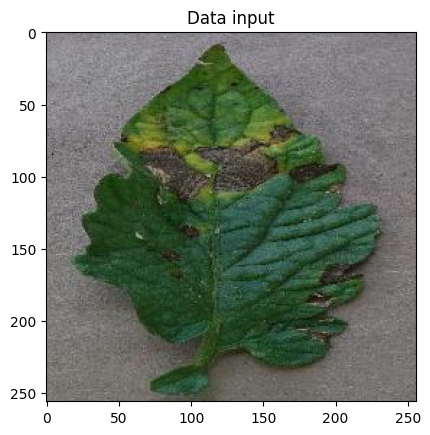

In [12]:
im=cv2.cvtColor(cv2.imread(r"..\src\features\test/TomatoEarlyBlight4.JPG"),cv2.COLOR_BGR2RGB)
im=my_preprocessing_func(im)
print("shape",im.shape)
d=im.reshape(1,256,256,3)
print("reshape",d.shape)
plt.imshow(d[0]);
plt.title("Data input")
cnn.predict(d)

In [25]:
# Extrait les sorties (outputs) des 12 couches supérieures
layer_outputs = [layer.output for layer in cnn.layers[0:20]] 

# Crée un modèle qui retournera ces sorties (outputs), étant donné l'entrée (input) du modèle.
activation_model = models.Model(inputs=cnn.input, outputs=layer_outputs) 

In [26]:
# Retourne une liste de cinq tableaux NumPy : un tableau par activation de couche
activations = activation_model.predict(d) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


(1, 256, 256, 3)


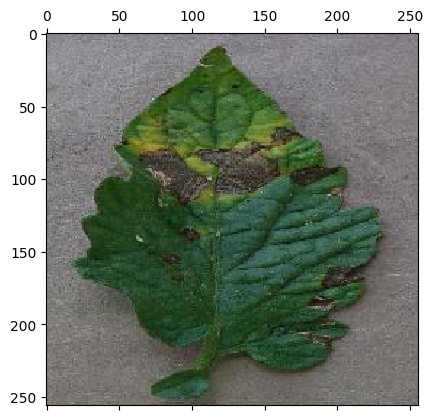

In [27]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)
plt.matshow(first_layer_activation[0, :, :], cmap='viridis');

C:\Users\artho\AppData\Local\Temp\ipykernel_54588\488027069.py:29: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
C:\Users\artho\AppData\Local\Temp\ipykernel_54588\488027069.py:21: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


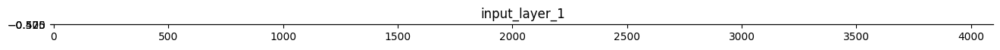

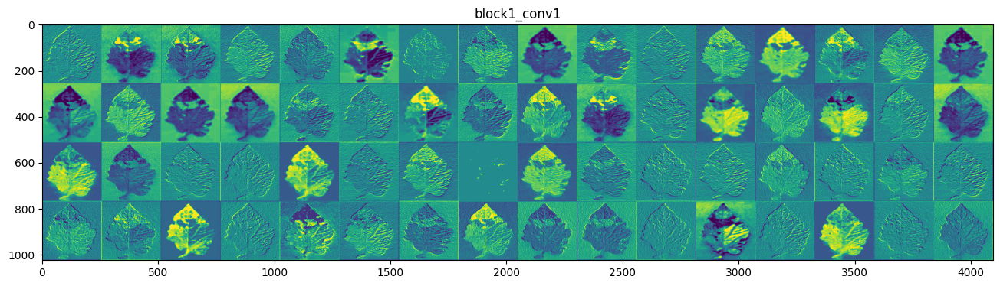

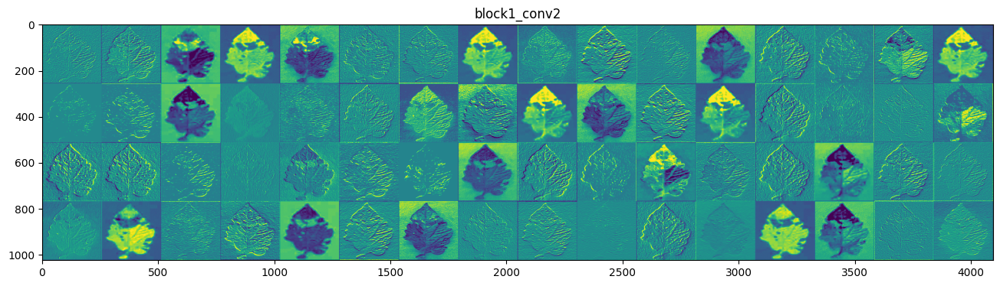

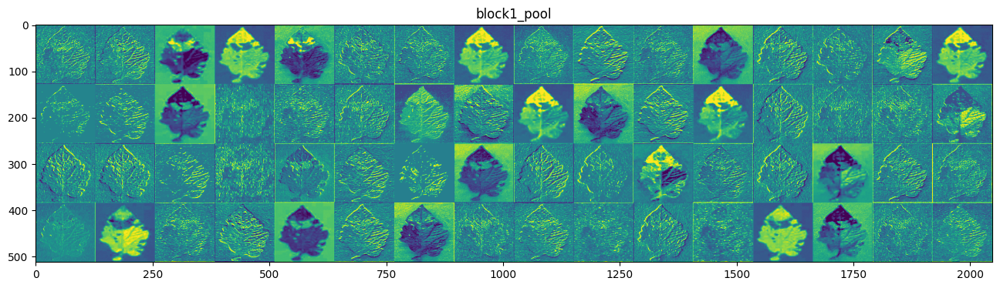

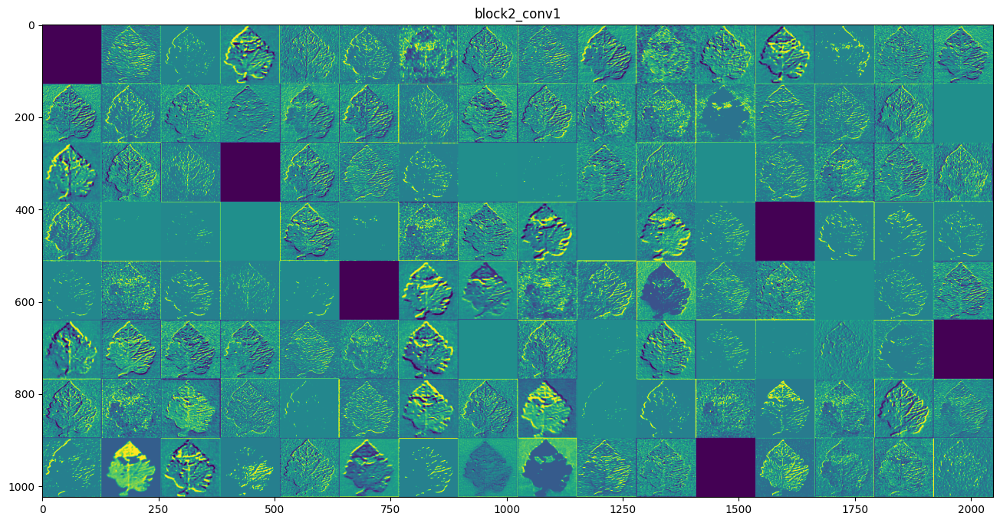

...

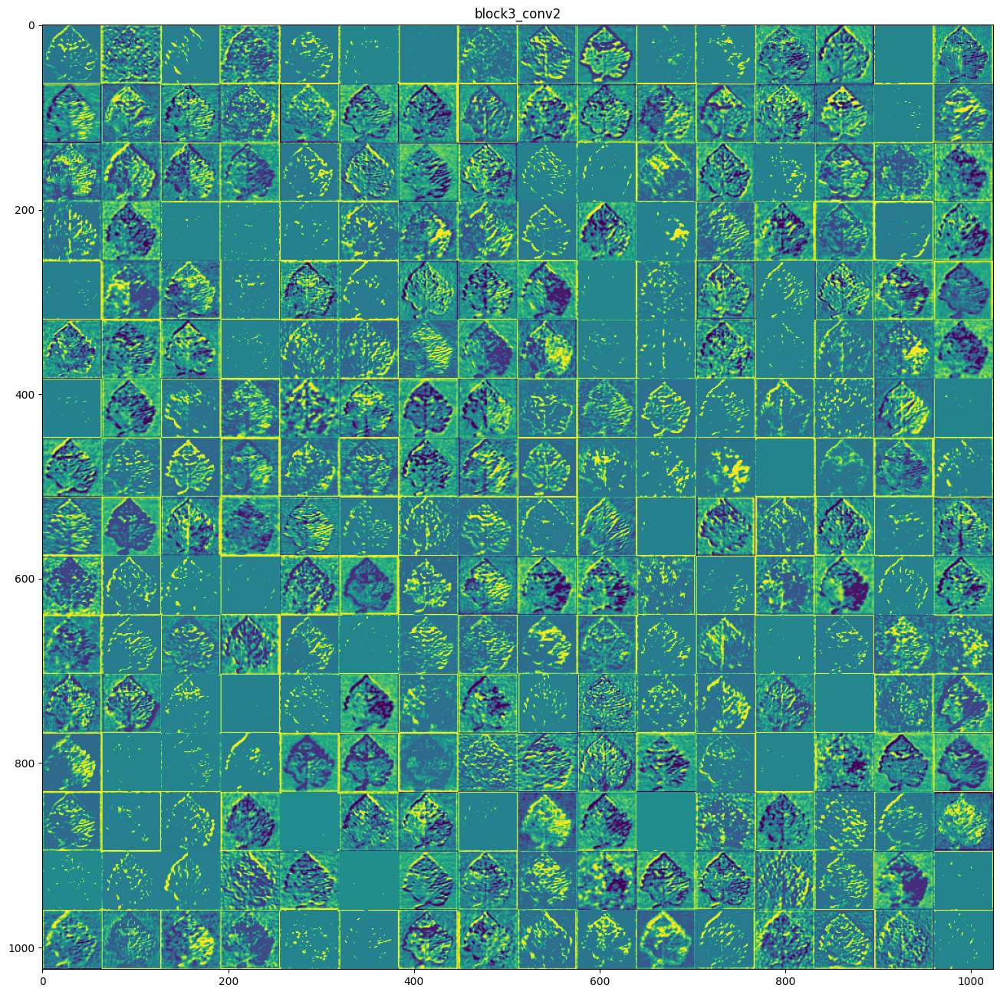

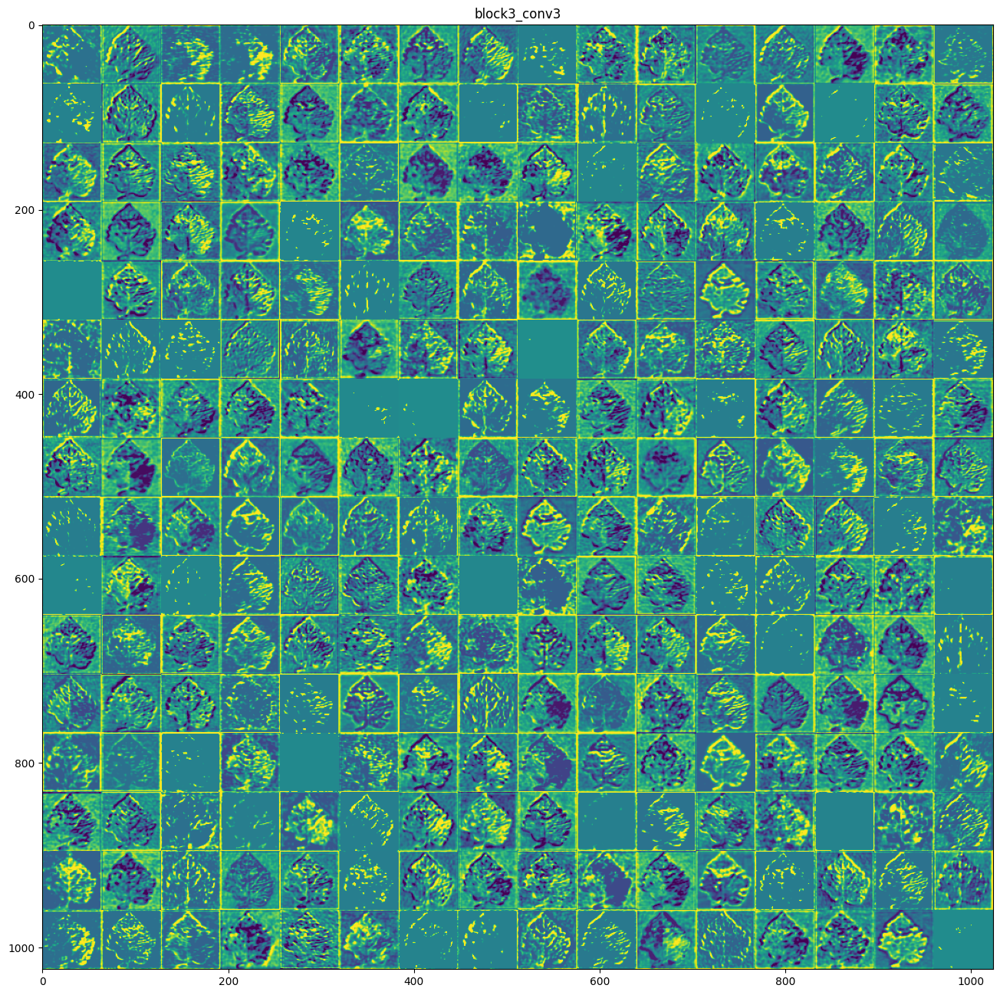

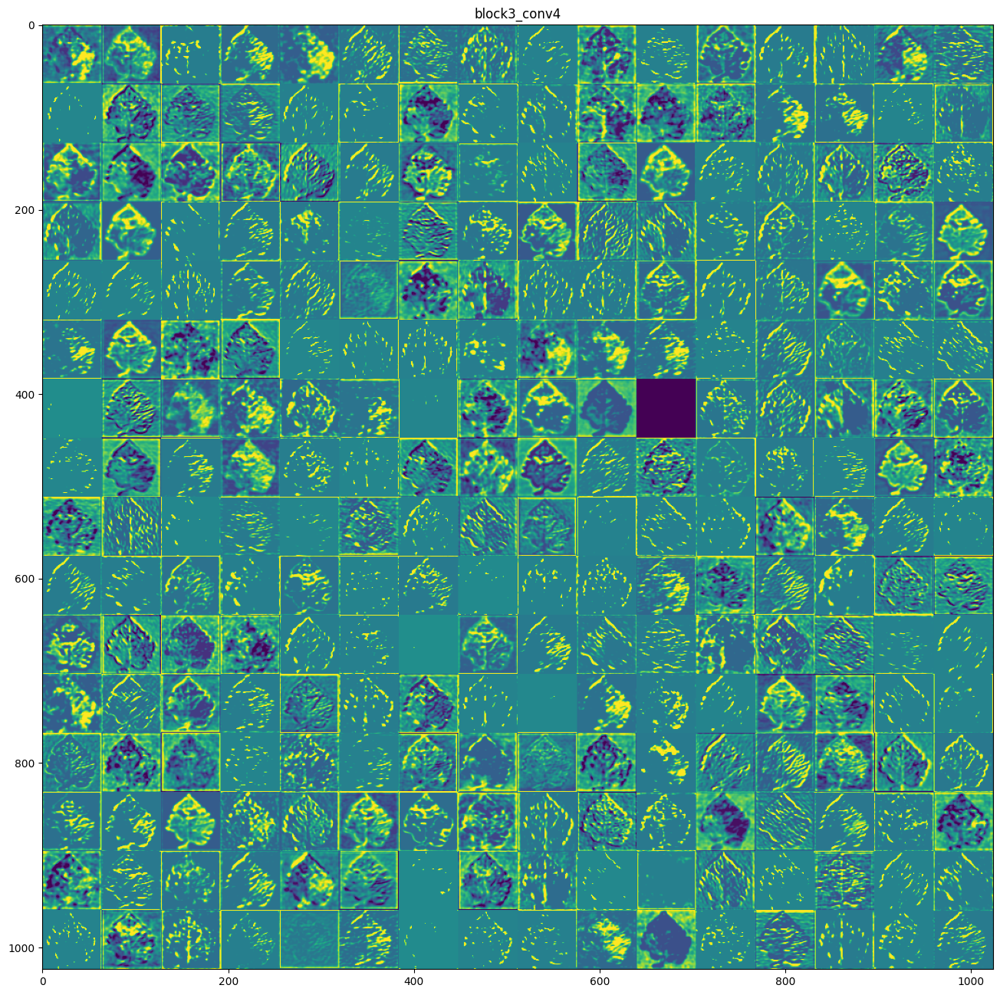

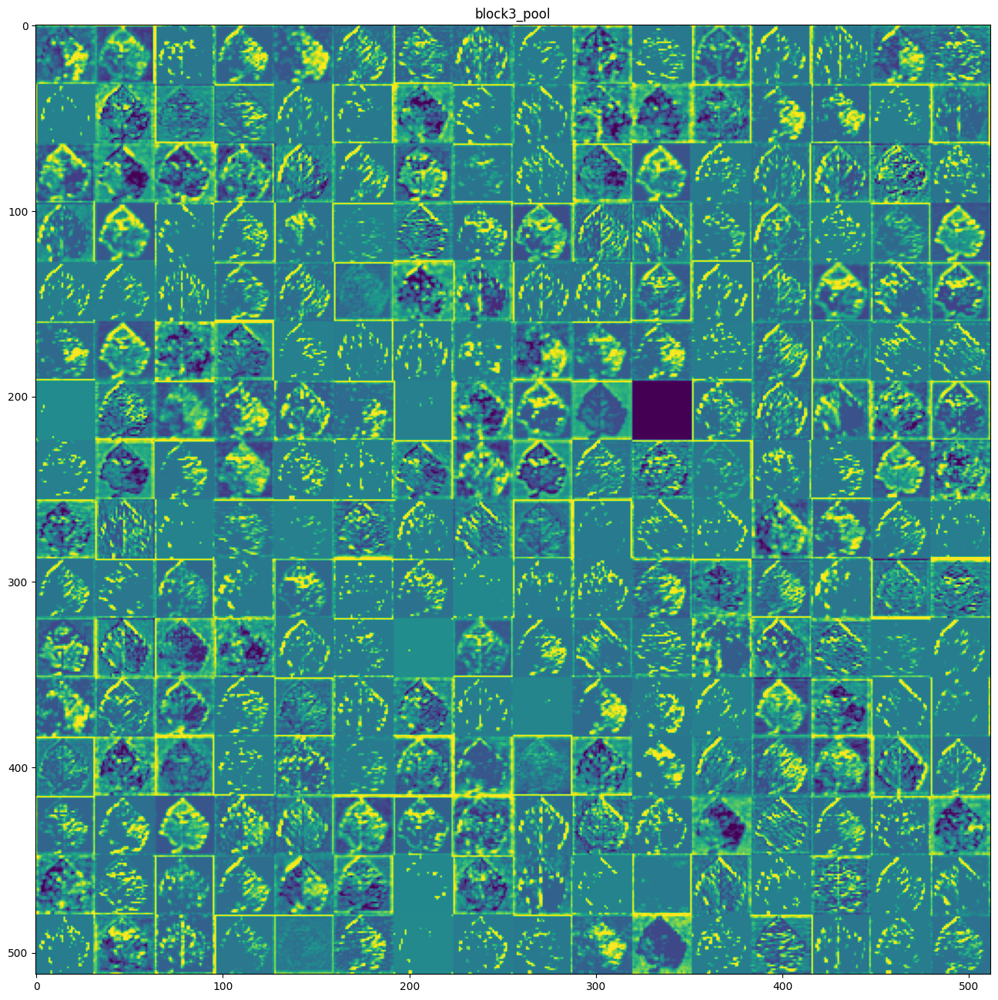

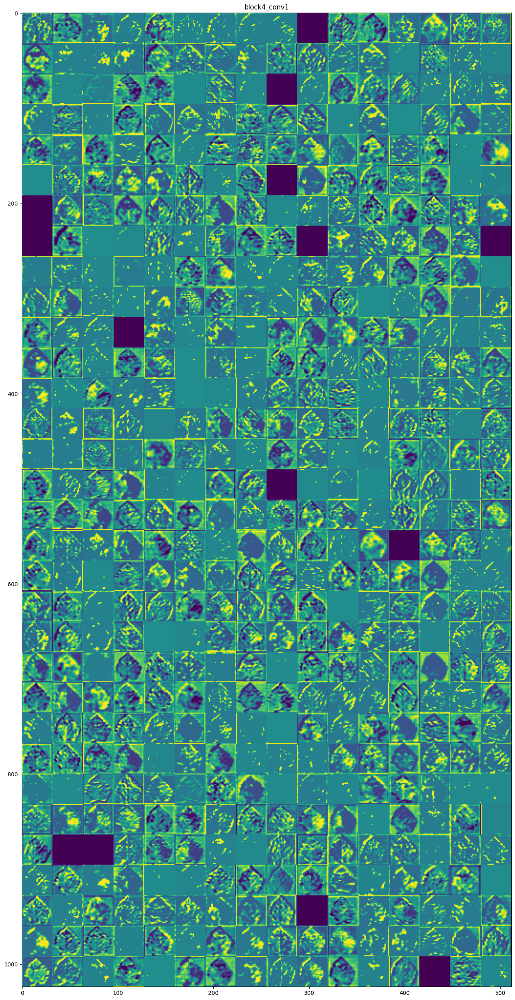

In [30]:
layer_names = []
for layer in cnn.layers[:13]:
    layer_names.append(layer.name) # Noms des couches, afin que vous puissiez les intégrer à votre graphique

images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations): # Affiche les cartes des features
    n_features = layer_activation.shape[-1] # Nombre de features dans la carte des features
    size = layer_activation.shape[1] # La carte des features a la forme/dimension suivante : (1, size, size, n_features).
    n_cols = n_features // images_per_row # Classer les canaux d'activation dans cette matrice
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols): # Classer chaque filtre dans une grande grille horizontale
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            channel_image -= channel_image.mean() # Post-traitement de la feature pour la rendre visuellement acceptable.
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, # Affiche la grille
                         row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')